# Electrophysiology 101

Neuronal electrophysiology (ephys) refers to the study of the electrical properties of cells and tissue in the nervous system. Ephys is one of the <em>most prevalent</em> types of studies in the field of Neuroscience and its benefits cannot be overstated. One type of ephys experiment is called extracellular electrophysiology which involves inserting a probe into the tissue of interest and studying the surrounding electrical activity in the presence of a stimulus.
    
While there are many ways to conduct an ephys experiment and structure its processing and analysis, the scope of the workflow described below refers to the approach DataJoint has taken as a result of extensive collaboration with neuroscience laboratories around the world.
    
### General Structure
   
1. The electrode arrays (probes) are inserted into the brain-area of interest. 
2. The user decides which area of the probe will be used (i.e a subset of the total number of electrodes.).
3. The researcher conducts the experiment, usually presenting some stimuli to the subject. 
4. The raw data is collected and clustered.
5. The data is further divided into the units, spike times, and waveforms.

    
More on Clustering:
The clustering analysis processes raw data and retrieves units, spiketimes, and waveforms.










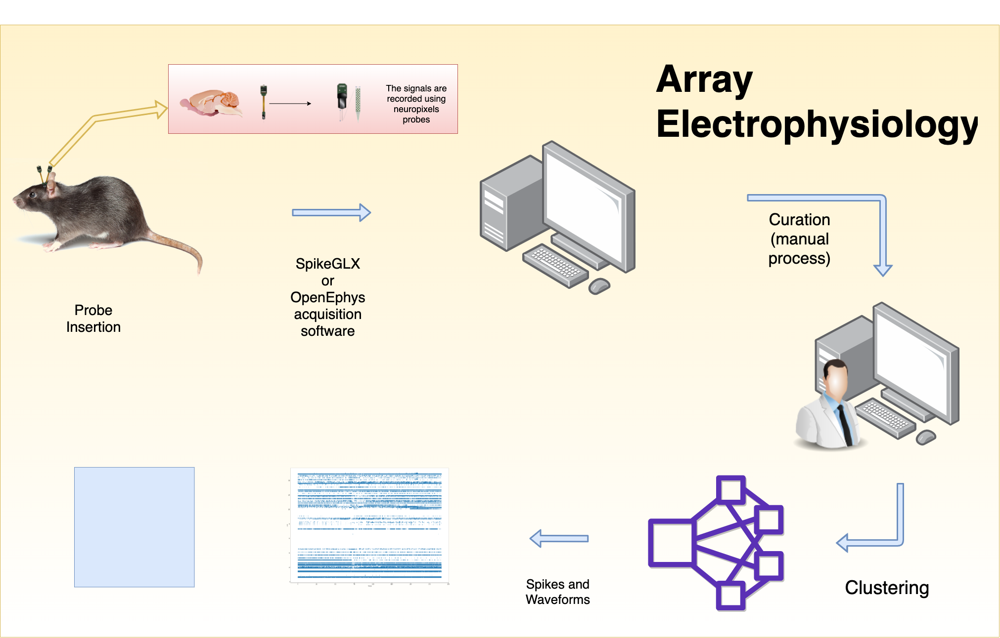

In [18]:
subject_table = dj.Diagram(probe) + ephys.ProbeInsertion + ephys.InsertionLocation + subject.Subject
subject_table.save('SUBJET.svg', format='svg')

In [11]:
subject.Subject()

subject,sex,subject_birth_date,subject_description
subject6,M,2020-01-04,
subject7,F,2020-01-02,hneih_E106


In [7]:
probe.ProbeType.Electrode & 'probe_type LIKE "%2.0%"'

probe_type e.g. neuropixels_1.0,"electrode electrode index, starts at 0","shank shank index, starts at 0, advance left to right","shank_col column index, starts at 0, advance left to right","shank_row row index, starts at 0, advance tip to tail","x_coord (um) x coordinate of the electrode within the probe, (0, 0) is the bottom left corner of the probe","y_coord (um) y coordinate of the electrode within the probe, (0, 0) is the bottom left corner of the probe"
neuropixels 2.0 - MS,0,0,0,0,0.0,0.0
neuropixels 2.0 - MS,1,0,1,0,32.0,0.0
neuropixels 2.0 - MS,2,0,0,1,0.0,15.0
neuropixels 2.0 - MS,3,0,1,1,32.0,15.0
neuropixels 2.0 - MS,4,0,0,2,0.0,30.0
neuropixels 2.0 - MS,5,0,1,2,32.0,30.0
neuropixels 2.0 - MS,6,0,0,3,0.0,45.0


In [47]:
ephys.EphysRecording & ephys.ClusteringTask

subject,session_datetime,insertion_number,electrode_config_hash,acq_software,sampling_rate (Hz)


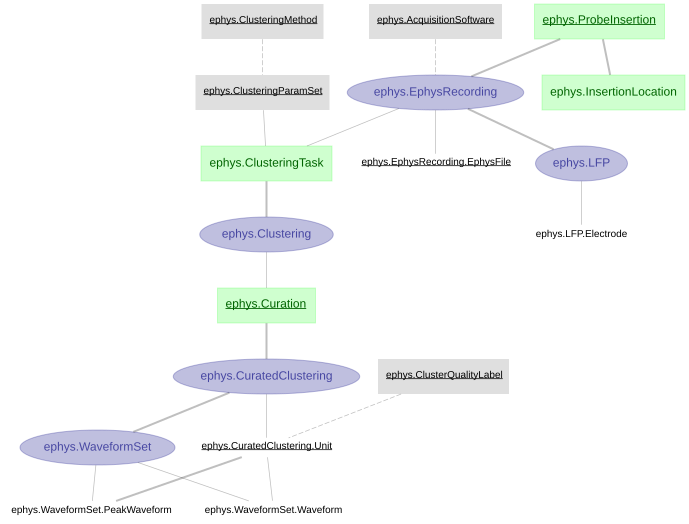

In [25]:
dj.Diagram(ephys)

In [4]:
import datajoint as dj
help(dj.Diagram)

Help on class Diagram in module datajoint.diagram:

class Diagram(networkx.classes.digraph.DiGraph)
 |  Diagram(source, context=None)
 |  
 |  Entity relationship diagram.
 |  
 |  Usage:
 |  
 |  >>>  diag = Diagram(source)
 |  
 |  source can be a base relation object, a base relation class, a schema, or a module that has a schema.
 |  
 |  >>> diag.draw()
 |  
 |  draws the diagram using pyplot
 |  
 |  diag1 + diag2  - combines the two diagrams.
 |  diag + n   - expands n levels of successors
 |  diag - n   - expands n levels of predecessors
 |  Thus dj.Diagram(schema.Table)+1-1 defines the diagram of immediate ancestors and descendants of schema.Table
 |  
 |  Note that diagram + 1 - 1  may differ from diagram - 1 + 1 and so forth.
 |  Only those tables that are loaded in the connection object are displayed
 |  
 |  Method resolution order:
 |      Diagram
 |      networkx.classes.digraph.DiGraph
 |      networkx.classes.graph.Graph
 |      builtins.object
 |  
 |  Methods defined

In [13]:
dj.Diagram(ephys).save('EPHYS.svg', format='svg')

In [61]:
clustering = dj.Diagram(ephys.Curation) + ephys.CuratedClustering.Unit +ephys.CuratedClustering+ ephys.Clustering + ephys.ClusteringMethod + ephys.ClusteringParamSet + ephys.ClusteringTask + ephys.ClusterQualityLabel
clustering.save('clustering.svg', format = 'svg')

In [36]:
new_probe = dj.Diagram(probe)
new_probe.save('newprobe.svg',format='svg')

In [15]:
ephys_and_friends = dj.Diagram(ephys.EphysRecording) + ephys.ClusteringTask + ephys.Clustering + ephys.EphysRecording.EphysFile + ephys.ClusteringParamSet + ephys.ClusteringMethod

In [40]:
probe.ProbeType & probe.ElectrodeConfig

probe_type e.g. neuropixels_1.0


In [16]:
ephys_and_friends.save('newEphys.svg', format = 'svg')

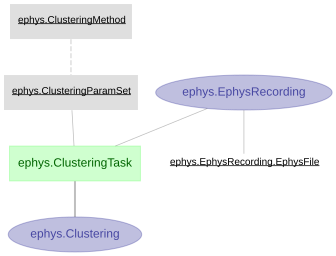

In [26]:
dj.Diagram(ephys.EphysRecording) + ephys.ClusteringTask + ephys.Clustering + ephys.EphysRecording.EphysFile + ephys.ClusteringParamSet + ephys.ClusteringMethod

# Introduction to the workflow structure

This notebook gives a brief overview of the workflow structure and introduces some useful DataJoint tools to facilitate the exploration.
+ DataJoint needs to be pre-configured before running this notebook, if you haven't set up the configuration, refer to notebook [01-configure](01-configure.ipynb).
+ If you are familar with DataJoint and the workflow structure, proceed to the next notebook [03-process](03-process.ipynb) directly to run the workflow.
+ For a more thorough introduction of DataJoint functionings, please visit our [general tutorial site](https://playground.datajoint.io)

To load the local configuration, we will change the directory to the package root.

In [45]:
import os
os.chdir('..')

## Schemas and tables

The current workflow is composed of multiple database schemas, each of them corresponds to a module within `workflow_array_ephys.pipeline`

In [46]:
import datajoint as dj
from workflow_array_ephys.pipeline import lab, subject, session, probe, ephys

In [44]:
ls

Data Structure Description.pdf  Task Description.pdf
Datajoint.JPG                   Untitled.ipynb
Dockerfile                      Untitled1.ipynb
EPHYS                           Untitled2.ipynb
EPHYS.svg                       docker-compose.debug.yml
EPHYSSVG                        docker-compose.yml
EphysDiagram                    images for diagram/
Jupytext.ipynb                  newprobe.svg
Jupytext.py                     playground_tutorial/
Medium.pdf                      probeandsession
Misc./                          probeandsession.svg
NEWEPHYS.svg                    requirements.txt
Retinal_Ganglion_Neurons.ipynb  workflow-array-ephys/
SUBJET.svg                      workspace.code-workspace


In [5]:
probe.schema

Schema `neuro_probe`

In [6]:
ephys.schema

Schema `neuro_ephys`

In [7]:
# preview table columns and contents in a table
ephys.EphysRecording()

subject,session_datetime,insertion_number,electrode_config_hash,acq_software,sampling_rate (Hz)
subject6,2021-01-15 11:16:38,0,6f6d8149-1603-9d2c-f884-0fdf995ec8b3,SpikeGLX,30000.6
subject7,2021-01-15 11:16:38,0,6f6d8149-1603-9d2c-f884-0fdf995ec8b3,SpikeGLX,30000.6


In [49]:
ephys.EphysRecording()

subject,session_datetime,insertion_number,electrode_config_hash,acq_software,sampling_rate (Hz)


## DataJoint tools to explore schemas and tables

In [ ]:
dj.Diagram()

In [8]:
dj.list_schemas()

['neuro_ephys',
 'neuro_probe',
 'neuro_subject',
 'lab',
 'subject',
 'mysql',
 'performance_schema',
 'neuro_lab',
 'ephys',
 'neuro_session',
 'probe',
 'session']

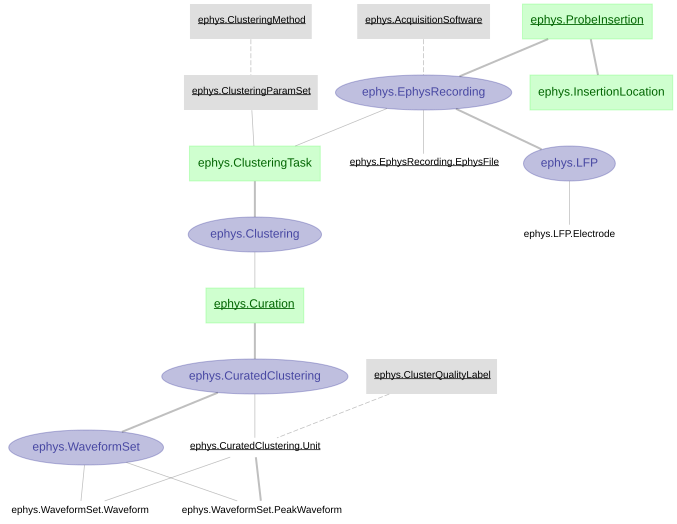

In [9]:
# plot diagram for all tables in a schema
dj.Diagram(ephys)

## The ephys diagram shows us the real world elements that the tables are modeling. 

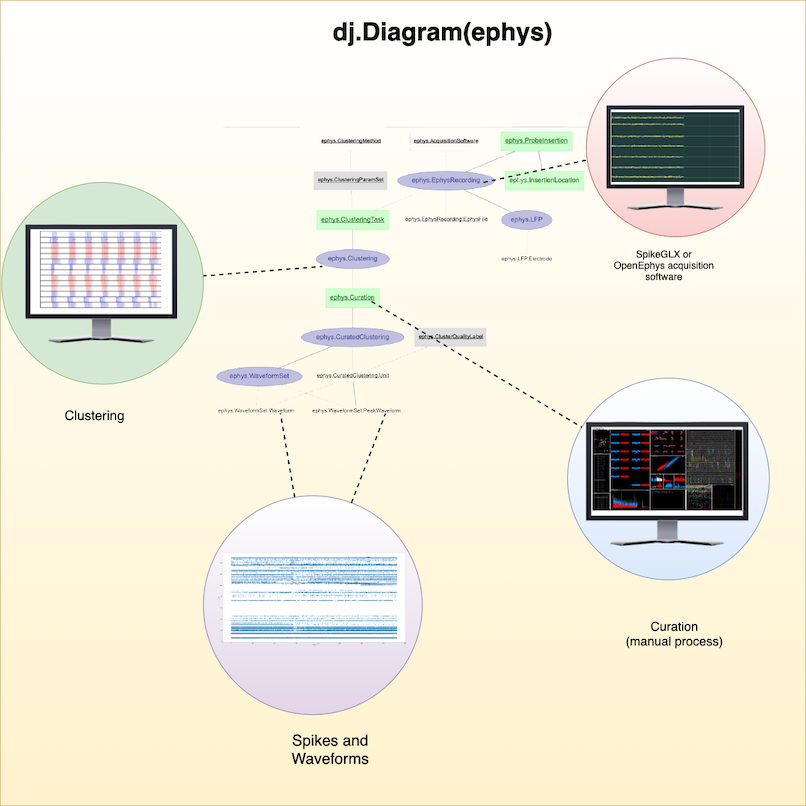

**Table tiers**: 

Manual table: green box, manually inserted table, expect new entries daily, e.g. Subject, ProbeInsertion.  
Lookup table: gray box, pre inserted table, commonly used for general facts or parameters. e.g. Strain, ClusteringMethod, ClusteringParamSet.  
Imported table: blue oval, auto-processing table, the processing depends on the importing of external files. e.g. process of Clustering requires output files from kilosort2.  
Computed table: red circle, auto-processing table, the processing does not depend on files external to the database, commonly used for     
Part table: plain text, as an appendix to the master table, all the part entries of a given master entry represent a intact set of the master entry. e.g. Unit of a CuratedClustering.

**Dependencies**:  

One-to-one primary: thick solid line, share the exact same primary key, meaning the child table inherits all the primary key fields from the parent table as its own primary key.     
One-to-many primary: thin solid line, inherit the primary key from the parent table, but have additional field(s) as part of the primary key as well
secondary dependency: dashed line, the child table inherits the primary key fields from parent table as its own secondary attribute.

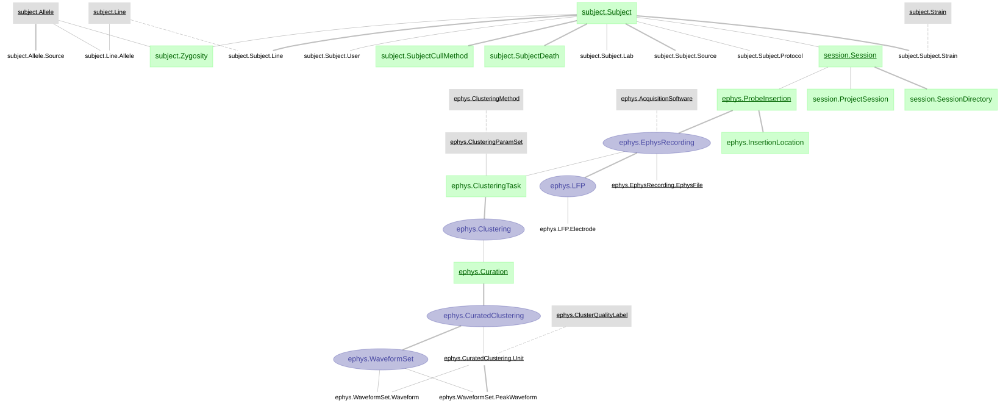

In [11]:
# plot diagram of tables in multiple schemas
dj.Diagram(subject) + dj.Diagram(session) + dj.Diagram(ephys)

In [12]:
#Show how the subject, session, and diagram are connected via diagram

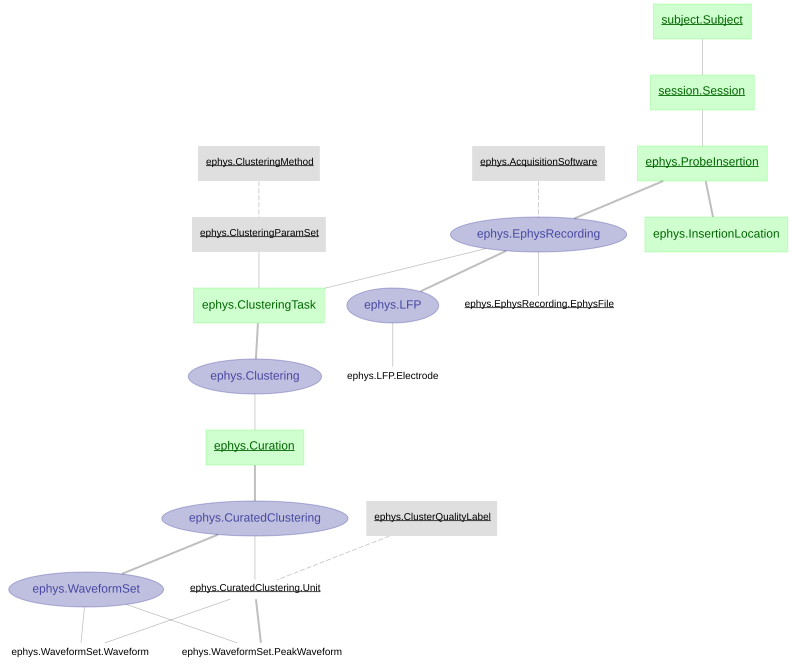

In [13]:
# plot diagram of selected tables and schemas
dj.Diagram(subject.Subject) + dj.Diagram(session.Session) + dj.Diagram(ephys)

In [14]:
ephys.CuratedClustering()

subject,session_datetime,insertion_number,paramset_idx,curation_id
subject6,2021-01-15 11:16:38,0,0,1


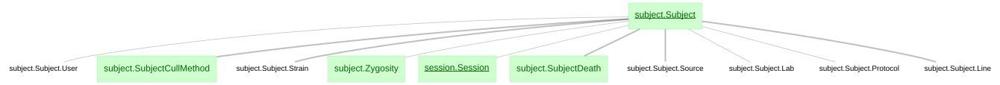

In [15]:
# plot diagram with 1 additional level of dependency downstream
dj.Diagram(subject.Subject) + 1

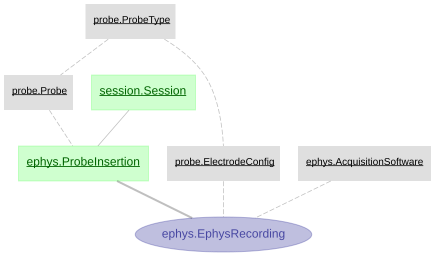

In [16]:
# plot diagram with 2 additional levels of dependency upstream
dj.Diagram(ephys.EphysRecording) - 2

In [24]:
probe_and_session = dj.Diagram(probe) + subject.Subject + session.Session + ephys.ProbeInsertion + ephys.InsertionLocation
probe_and_session.save('probeandsession.svg', format='svg')

<hr>

## Checkpoint 2
If I was at the examining the data at the ephys.ClusteringTask table, and I wanted more data regarding the subject regarding the subject's zygosity, what schema and table could I use to find that information? (Hint: You can trace the pipeline, explore different schemas to find this answer). 

<hr>

In [17]:

ephys.EphysRecording.describe();

# <hr/>

# Ephys recording from a probe insertion for a given session.
-> ephys.ProbeInsertion
---
-> probe.ElectrodeConfig
-> ephys.AcquisitionSoftware
sampling_rate        : float                        # (Hz)



In [30]:
probe.ProbeType()

probe_type e.g. neuropixels_1.0
neuropixels 1.0 - 3A
neuropixels 1.0 - 3B
neuropixels 2.0 - MS
neuropixels 2.0 - SS


In [18]:
#The bottom three cells are just a space for me to explore a little 

In [19]:
#First table
ephys.ProbeInsertion()

subject,session_datetime,insertion_number,probe unique identifier for this model of probe (e.g. serial number)
subject6,2021-01-15 11:16:38,0,17131311651
subject7,2021-01-15 11:16:38,0,17131311651


In [20]:
ephys.AcquisitionSoftware()

acq_software
Open Ephys
SpikeGLX


In [24]:
ephys.EphysRecording()

subject,session_datetime,insertion_number,electrode_config_hash,acq_software,sampling_rate (Hz)
subject6,2021-01-15 11:16:38,0,6f6d8149-1603-9d2c-f884-0fdf995ec8b3,SpikeGLX,30000.6
subject7,2021-01-15 11:16:38,0,6f6d8149-1603-9d2c-f884-0fdf995ec8b3,SpikeGLX,30000.6


<hr/>

subject,sex,subject_birth_date,subject_description


In [22]:
ephys.EphysRecording.heading

# Ephys recording from a probe insertion for a given session.
subject              : varchar(32)                  # 
session_datetime     : datetime(3)                  # 
insertion_number     : tinyint unsigned             # 
---
electrode_config_hash : uuid                         # 
acq_software         : varchar(24)                  # 
sampling_rate        : float                        # (Hz)

<hr>

## Checkpoint 3
What is the difference between the `.heading` attribute and the `.describe()` method? 

<hr>

# Major DataJoint Elements installed in the current workflow

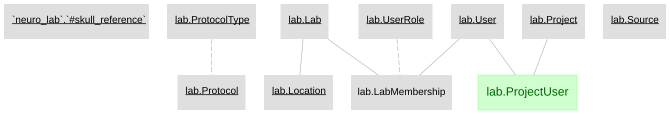

In [23]:
dj.Diagram(lab)

In [29]:
ephys.EphysRecording()

subject,session_datetime,insertion_number,electrode_config_hash,acq_software,sampling_rate (Hz)


In [25]:
help(ephys.EphysRecording())

Help on EphysRecording in module element_array_ephys.ephys object:

class EphysRecording(datajoint.user_tables.Imported)
 |  Table definition:
 |  
 |  
 |      # Ephys recording from a probe insertion for a given session.
 |      -> ProbeInsertion      
 |      ---
 |      -> probe.ElectrodeConfig
 |      -> AcquisitionSoftware
 |      sampling_rate: float # (Hz)
 |  
 |  Method resolution order:
 |      EphysRecording
 |      datajoint.user_tables.Imported
 |      datajoint.user_tables.UserTable
 |      datajoint.table.Table
 |      datajoint.expression.QueryExpression
 |      datajoint.autopopulate.AutoPopulate
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  make(self, key)
 |      Derived classes must implement method `make` that fetches data from tables that are
 |      above them in the dependency hierarchy, restricting by the given key, computes dependent
 |      attributes, and inserts the new tuples into self.
 |  
 |  ------------------------------------------

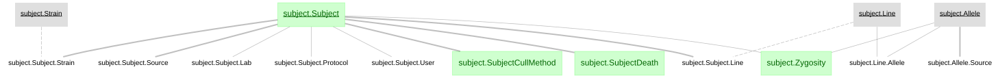

In [25]:

dj.Diagram(subject)

In [26]:
subject.Subject.describe();

# Animal Subject
subject              : varchar(32)                  
---
sex                  : enum('M','F','U')            
subject_birth_date   : date                         
subject_description="" : varchar(1024)                



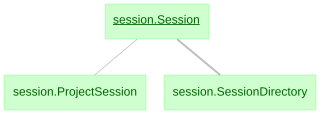

In [27]:

dj.Diagram(session)

In [28]:
session.Session.describe();

-> subject.Subject
session_datetime     : datetime(3)                  



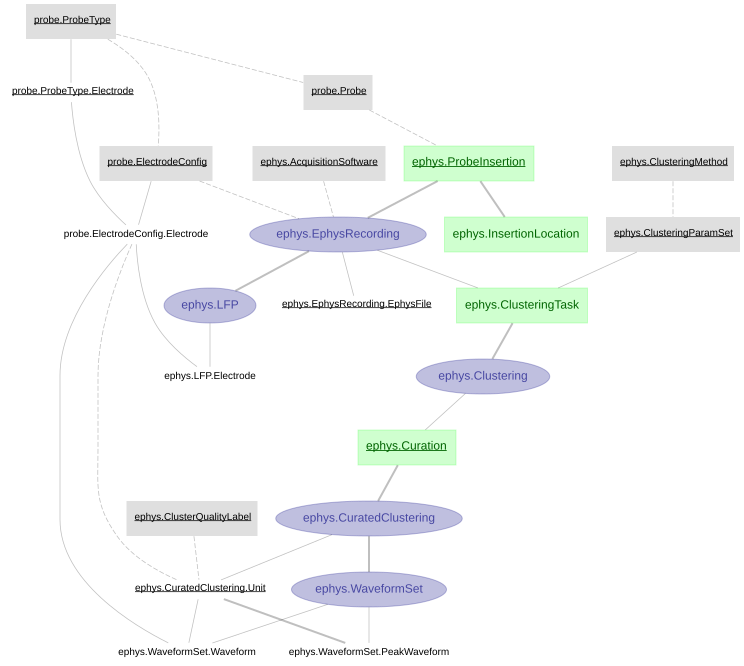

In [29]:
dj.Diagram(probe) + dj.Diagram(ephys)

In [30]:
ephys.LFP()

subject,session_datetime,insertion_number,lfp_sampling_rate (Hz),lfp_time_stamps (s) timestamps with respect to the start of the recording (recording_timestamp),"lfp_mean (uV) mean of LFP across electrodes - shape (time,)"


In [31]:
ephys.LFP.Electrode()

subject,session_datetime,insertion_number,electrode_config_hash,probe_type e.g. neuropixels_1.0,"electrode electrode index, starts at 0",lfp (uV) recorded lfp at this electrode


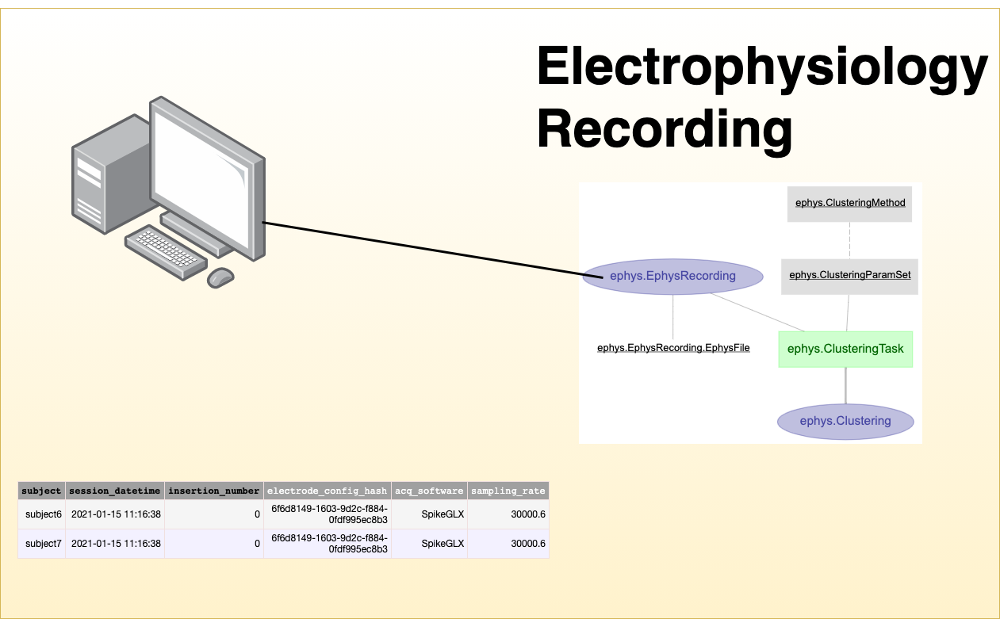

## Summary and next step

+ This notebook introduced the overall structures of the schemas and tables in the workflow and relevant tools to explore the schema structure and table definitions.

+ In the next notebook [03-process](03-process.ipynb), we will further introduce the detailed steps running through the pipeline and table contents accordingly.

## Question Categories
### DataJoint Questions
Question type:
1. Theory
2. Recall (from information contained in notebook02)
3. Inference/Recall
4. Inference
5. Recall


### Workflow Questions
Question type:
1. Exploratory
2. Exploratory
3. Inference
4. Understanding 
5. 


## DataJoint Questions
1. What is the difference between the `.heading` attribute and the `.describe()` method?
2. The `ephys.EphysRecording` table is shown in the Diagram inside a blue bubble, while `ephys.ProbeInsertion` is shown in a green box. What do the color differences tell us about these tables? 
3. We see in the `ephys.LFP.Electrode` table that the primary keys are inherited from the `ephys.LFP` table and the `probe.ElectrodeConfig.Electrode` table. What does this tell us about the way inheritance can work across schemas? 
4. What does `ephys.EphysRecording` being connected to `ephys.LFP` by a thick, solid tell me? 
5. What do the dashed lines tell me about the relationship between ephys.AcquisitionSoftware and ephys.EphysRecording?

## Workflow Questions
1. Which table tells us the probe and electrode a unit is coming from? (Hint: You can hover over the tables diagram to see their fields.)
2. If I was at the examining the data at the `ephys.EphysRecording` table, and I wanted more data regarding the subject regarding the subject's zygosity, what schema and table could I use to find that information? (Hint: You can trace the pipeline, explore different schemas to find this answer).
3. The tables `ephys.ClusteringTask` and `ephys.Curation` both have a field pointing Datajoint to an output directory. Under what conditions would these fields be the same? Under what conditions would these fields be different?
4. What is the difference between `ephys.WaveformSet.PeakWaveform` and `ephys.WaveformSet.Waveform`?(Hint: look at the fields in both.)
5. 